In [1]:
%load_ext autoreload
%autoreload 2

# Base Notebook to re-create figures of _

This notebook is the base notebook for 10X's Xenium brain showcase tissue sample. It runs the standard ovrlpy pipeline and saves the results to be used in further analysis.

In [2]:
from pathlib import Path

data_folder_path = Path("/dh-projects/ag-ishaque/raw_data/tiesmeys-ovrlpy/Xenium-brain-2024/replicate1")


### Data loader:

In [4]:
import pandas as  pd

coordinate_df = pd.read_parquet(data_folder_path/"transcripts.parquet")
coordinate_df["feature_name"]=coordinate_df.feature_name.str.decode("utf-8")

# remove dummy molecules:
dummy_mask = (coordinate_df.feature_name.str.contains('BLANK') | coordinate_df.feature_name.str.contains('NegControl'))
coordinate_df = coordinate_df[~dummy_mask]

# format columns:
coordinate_df = coordinate_df[['x_location','y_location','z_location','feature_name','cell_id','overlaps_nucleus','qv']]
coordinate_df.columns = ['x','y','z','gene','cell_id','overlaps_nucleus','qv']
coordinate_df['gene'] = coordinate_df['gene'].astype("category")

print(f"Number of cells: {coordinate_df.cell_id.nunique()}",f"Number of genes: {coordinate_df.gene.nunique()}",f"Number of molecules: {coordinate_df.shape[0]}",sep="\n")

Number of cells: 162034
Number of genes: 248
Number of molecules: 62384369


In [7]:
import os

os.listdir('./publication')

['simulations', 'vizgen-liver', 'vizgen-receptor', 'xenium-brain']

### Run the basic ovrlppy pipeline:

We expect a roughly estimated 30 cell types in the sample. For the remaining parameters, we use the default values.

Running vertical adjustment
Creating gene expression embeddings for visualization:
Analyzing in 3d mode:
determining pseudocells:
found 62341 pseudocells
sampling expression:


Zfpm2: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 248/248 [01:42<00:00,  2.41it/s]


Modeling 30 pseudo-celltype clusters;


/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/numpy/_core/_methods.py:130: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


Creating signal integrity map:


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 70/70 [11:02<00:00,  9.47s/it]
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


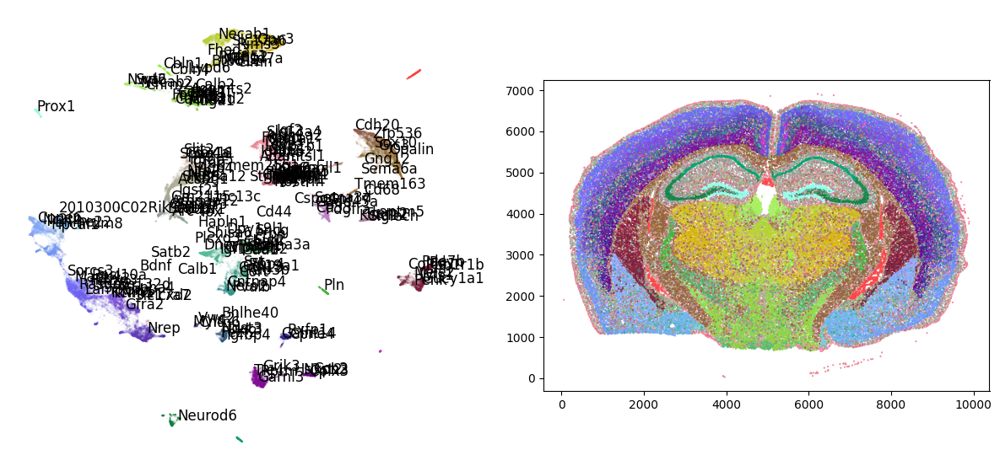

In [9]:
import sys

sys.path.append("/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24")
from ovrlpy_24 import ovrlpy 

signal_integrity, signal_strength,visualizer = ovrlpy.run(coordinate_df, n_expected_celltypes=30)

visualizer.plot_fit()

visualizer.save("./publication/xenium-brain/xenium-brain.vis")

### UMAP annotation using external gene expression signatures:

We can use external gene expression signatures to annotate the UMAP. In this case, we use cell features extracted from the allen brain atlas (REF):

/tmp/ipykernel_2943635/2917016521.py:9: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  signatures = signatures.fillna(0.0)


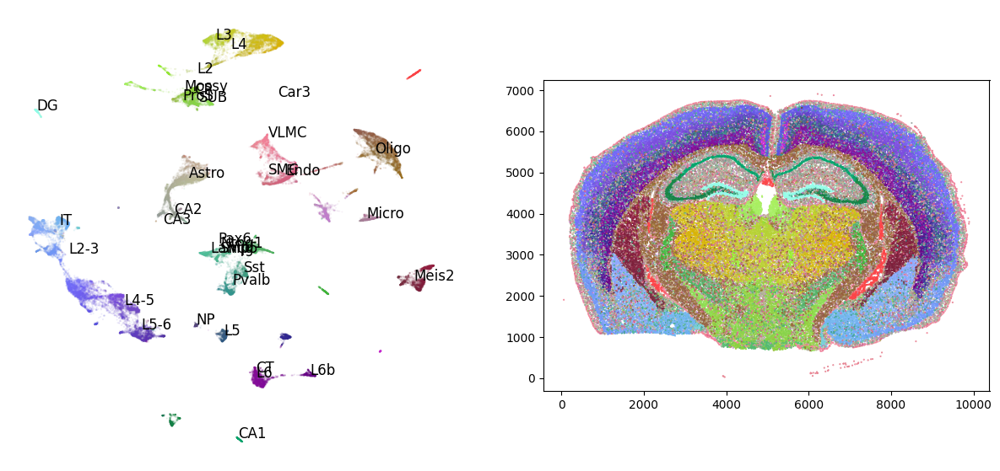

In [10]:
import numpy as np
import matplotlib.pyplot as plt

signatures_ = pd.read_csv('/dh-projects/ag-ishaque/raw_data/Xenium-benchmark/scRNAseq/trimmed_means.csv',index_col=0)

signatures_ = signatures_.T.groupby(lambda x: x.split('_')[1].split(' ')[0].split('-')[0]).apply(lambda x: x.mean(0)).T

signatures = pd.DataFrame(index=visualizer.genes,columns=signatures_.columns)
signatures = signatures.fillna(0.0)

for gene in visualizer.genes:
    if gene in signatures_.index:
        signatures.loc[gene] = signatures_.loc[gene]

del signatures_ 

signatures.columns=signatures.columns.str.replace('/','-')

visualizer.fit_signatures(signatures)

visualizer.plot_fit()

# plt.savefig("./manuscript/figures/results/xenium-brain/ct_fit.svg")

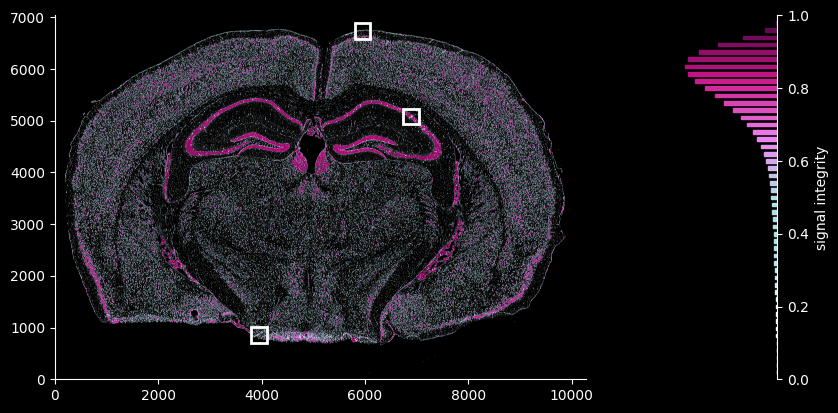

In [16]:
cm = 1/2.54  # centimeters in inches

xlims = [[5800, 6100],
       [6700+40, 7000+40],
       [3800, 4100],]
ylims = [[6600-10, 6900-10],
       [5000-70, 5300-70],
       [ 710, 1010],]

fig, ax = ovrlpy.plot_signal_integrity(
    signal_integrity, signal_strength, signal_threshold=3, figure_height=12*cm
)
for i in range(3):
    ax[0].add_artist(plt.Rectangle((xlims[i][0],ylims[i][0]),xlims[i][1]-xlims[i][0],ylims[i][1]-ylims[i][0],fill=None,edgecolor='w',lw=2))
    # txt = plt.text(xlims[i][0]-10,ylims[i][1],f'{i+1}',color='w',fontsize=20,ha='right',va='top')

plt.savefig('./publication/xenium-brain/figures/xenium_integrity_with_highlights.svg',dpi=300)

/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


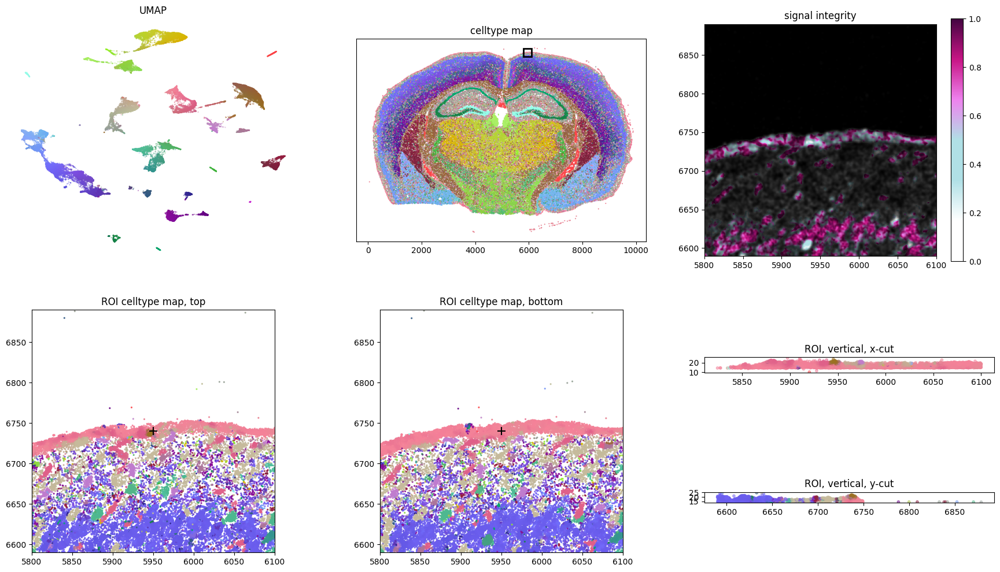

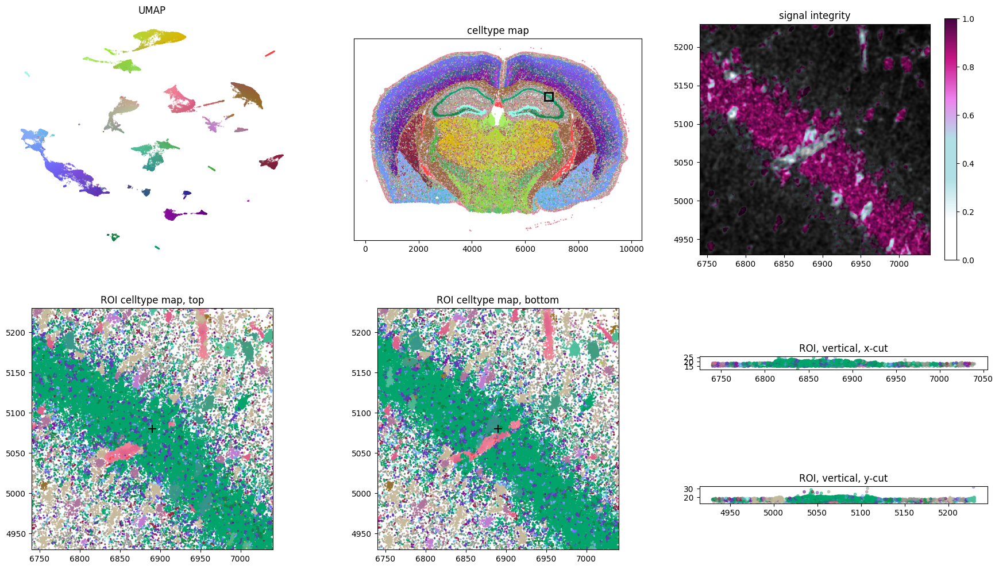

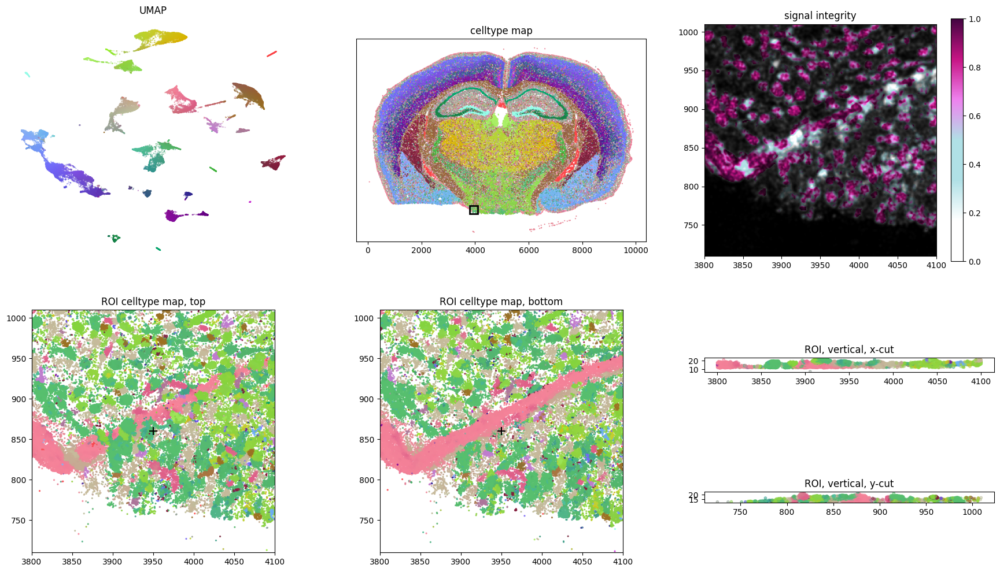

In [17]:
for i in range(len(xlims)):
    ovrlpy.plot_region_of_interest(xlims[i][0]+(xlims[i][1]-xlims[i][0])/2,
                                   ylims[i][0]+(ylims[i][1]-ylims[i][0])/2,
                                   coordinate_df,
                                   visualizer,
                                   signal_integrity,
                                   signal_strength,
                                   window_size=150,
                                   )
    plt.savefig(f'./publication/xenium-brain/figures/xenium_highlight_map_{i+1}.svg',dpi=300)

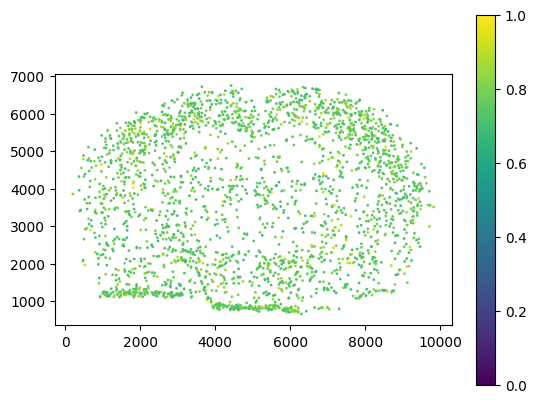

In [12]:
doublet_df = ovrlpy.detect_doublets(
    signal_integrity, signal_strength, minimum_signal_strength=3, integrity_sigma=2
)

_ = plt.scatter(
    doublet_df["x"],
    doublet_df["y"],
    c=doublet_df["integrity"],
    s=1,
    cmap="viridis",
    vmin=0,
    vmax=1,
)
plt.gca().set_aspect("equal")
plt.colorbar()

/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/sklear

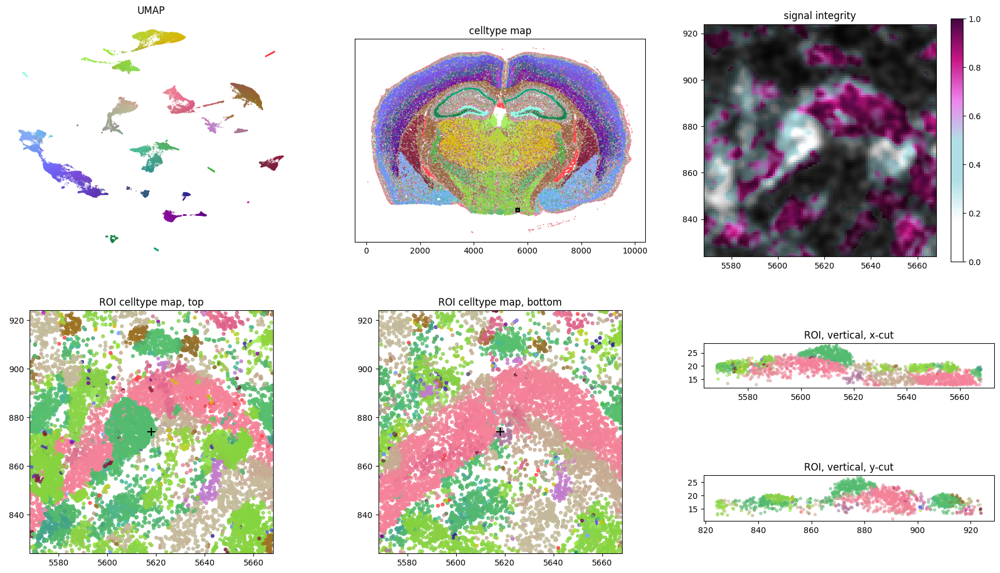

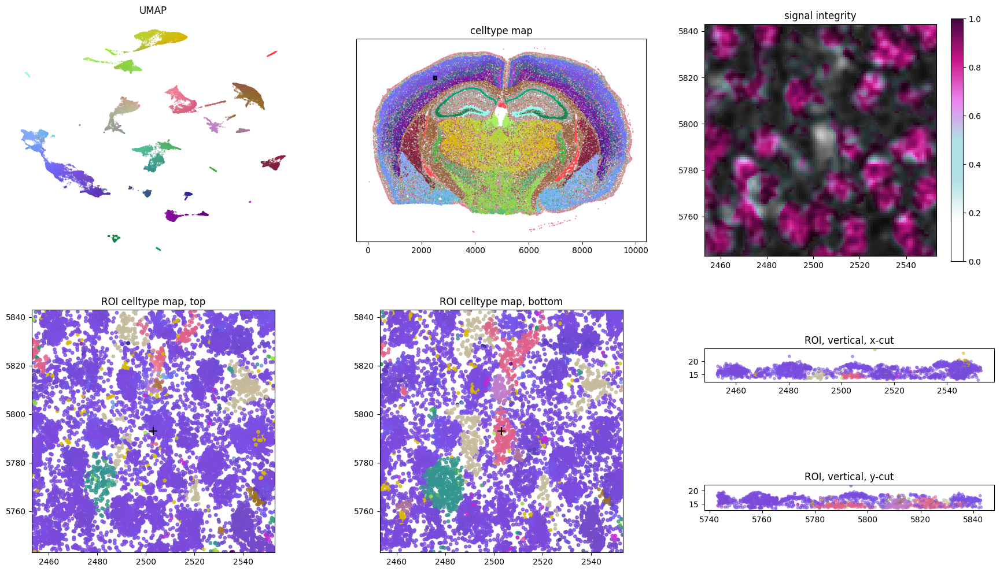

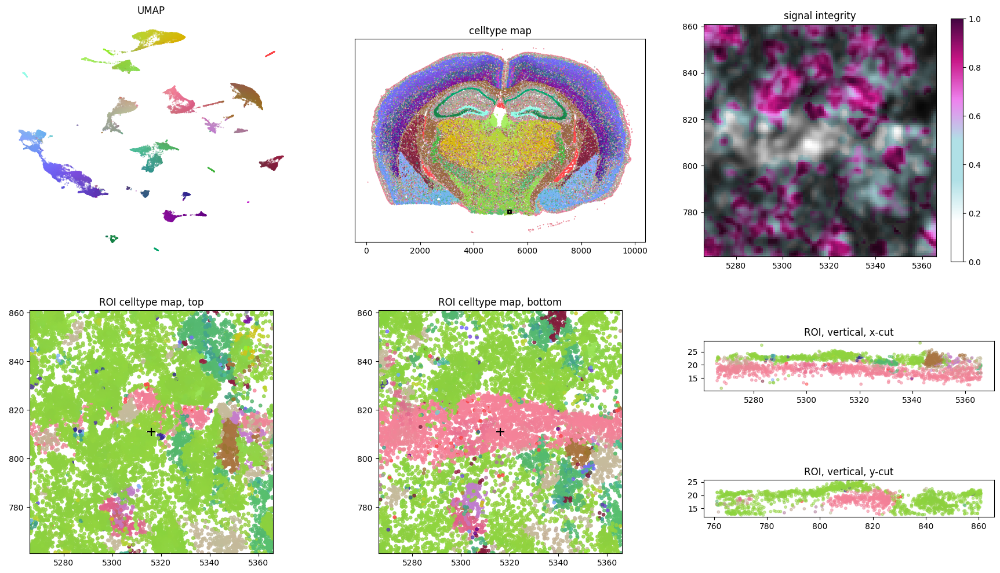

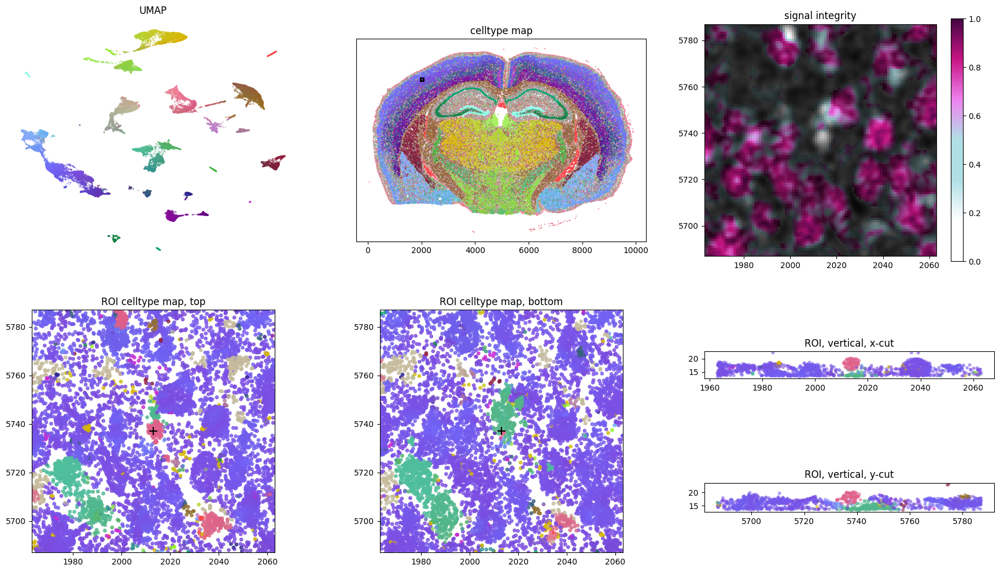

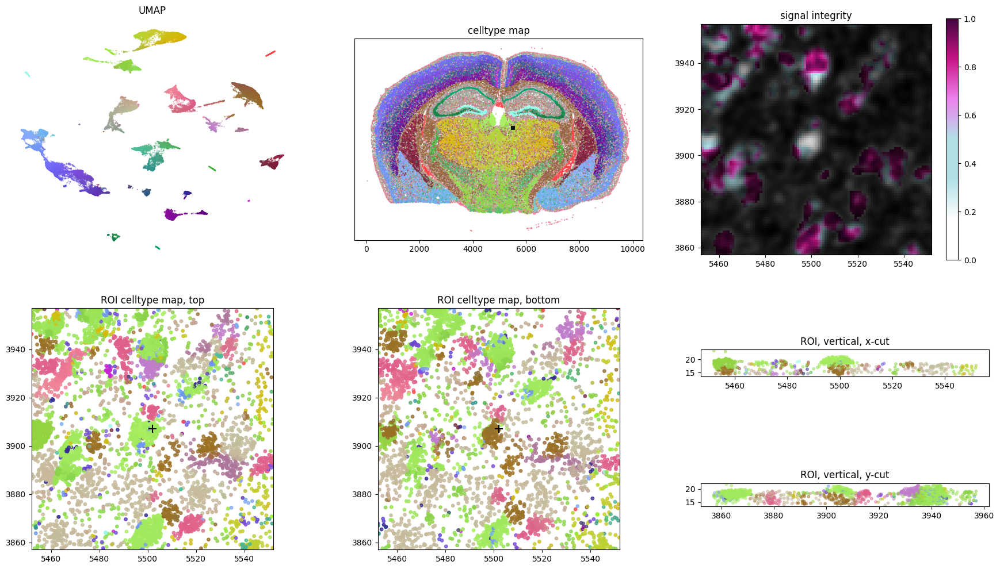

...

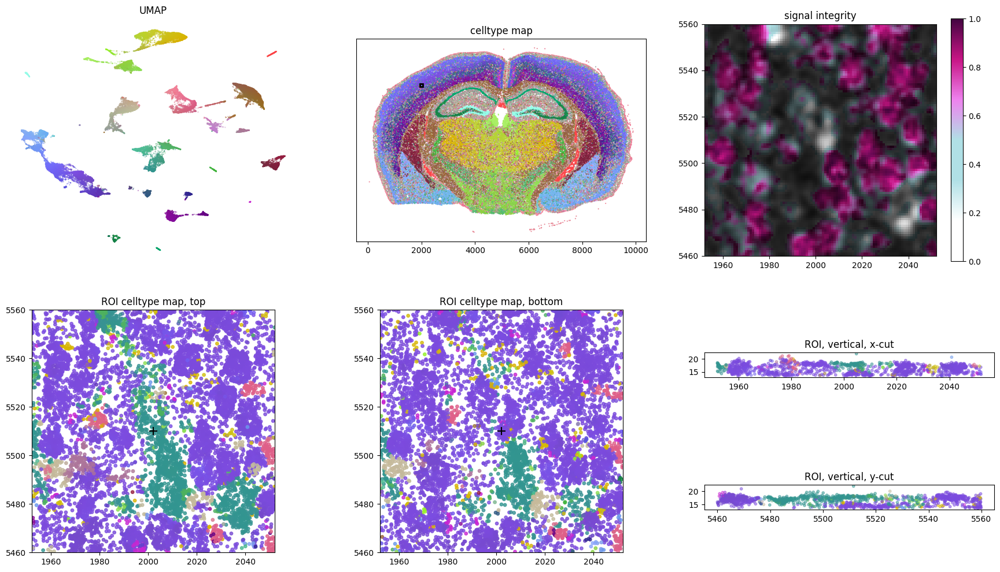

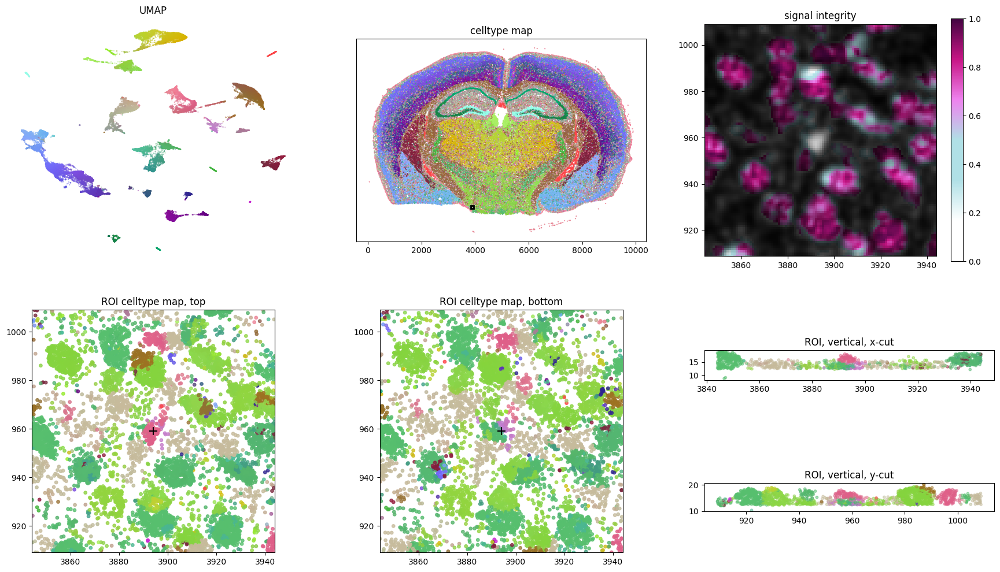

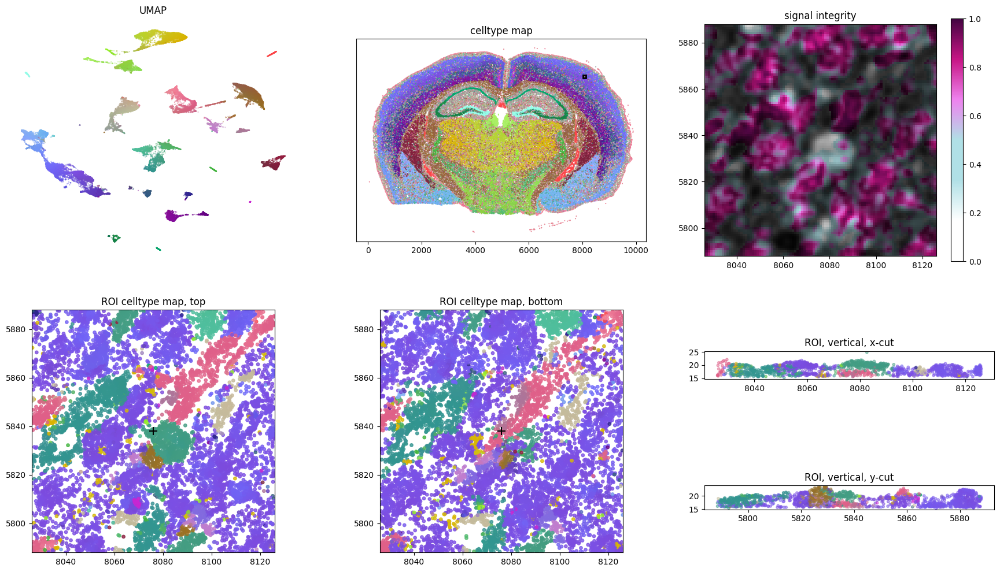

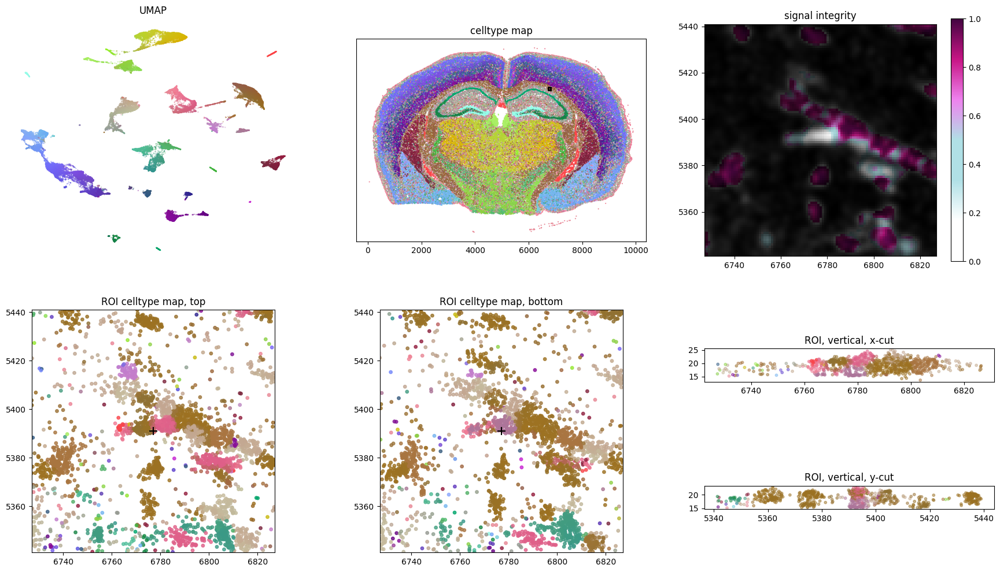

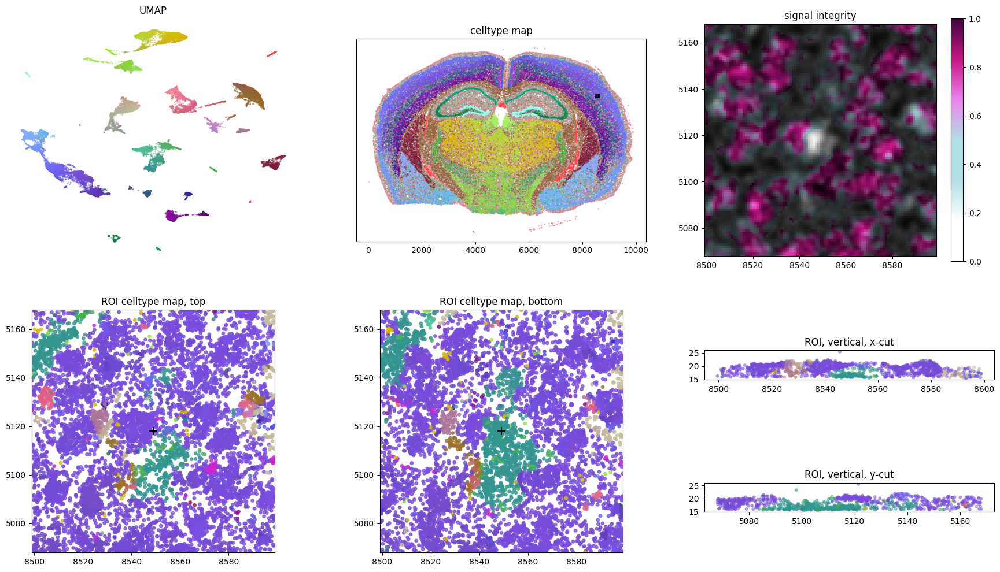

In [18]:
window_size = 50

for doublet_case in range(20):
    x, y = doublet_df.loc[doublet_case, ["x", "y"]]

    ovrlpy.plot_region_of_interest(
        x,
        y,
        coordinate_df,
        visualizer,
        signal_integrity,
        signal_strength,
        window_size=window_size,
    )
    
    plt.savefig(f'./publication/xenium-brain/figures/doublet-case-visualizations/xenium_doublet_case_{doublet_case+1}.svg',dpi=300)